# AlexNet-based Aircraft Detector Pipeline

This notebook walks through the full workflow for building an Airbus airplane detector on 2560×2560 satellite tiles: downloading the data, exploring its structure, defining helper utilities, fitting an AlexNet-based detection model, and finally validating/inferencing on held-out samples.


In [17]:
from typing import Any, Dict, List, Optional, Sequence, Tuple

import ast
import json
import math
import random
import subprocess
import time
import warnings
from collections import Counter, defaultdict, OrderedDict
from dataclasses import dataclass
from functools import partial
from pathlib import Path
import shutil

import matplotlib.pyplot as plt
import numpy as np
import optuna
import pandas as pd
import seaborn as sns
import torch
from IPython import display
from PIL import Image, ImageDraw
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms import functional as F
from torchvision.models import AlexNet_Weights
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.ops import box_iou

from alexnet_detector_custom import ClassicAlexNetBackbone, build_alexnet_detector as build_custom_alexnet_detector
from tqdm.auto import tqdm

import zipfile

# Download the dataset if it is empty

In [18]:
DATASET_ID = "airbusgeo/airbus-aircrafts-sample-dataset"
DATA_DIR = Path("dataset")
DATASET_NAME = "airbus-aircrafts-sample-dataset"
DATASET_DIR = DATA_DIR / DATASET_NAME
ZIP_PATH = DATA_DIR / f"{DATASET_NAME}.zip"

if DATASET_DIR.exists():
    print(f"Dataset already available at {DATASET_DIR.resolve()}")
else:
    DATA_DIR.mkdir(parents=True, exist_ok=True)

    print(f"Downloading {DATASET_ID} ...")
    try:
        subprocess.run(
            [
                "kaggle",
                "datasets",
                "download",
                "-d",
                DATASET_ID,
                "-p",
                str(DATA_DIR),
            ],
            check=True,
        )
    except FileNotFoundError as exc:
        raise RuntimeError(
            "Kaggle CLI is not installed or not on PATH."
        ) from exc
    except subprocess.CalledProcessError as exc:
        raise RuntimeError(
            "Failed to download dataset. Ensure Kaggle CLI is authenticated."
        ) from exc

    if not ZIP_PATH.exists():
        raise FileNotFoundError(f"Expected archive {ZIP_PATH} not found after download.")

    print(f"Unzipping {ZIP_PATH} ...")
    with zipfile.ZipFile(ZIP_PATH, "r") as zip_ref:
        zip_ref.extractall(DATASET_DIR)

    ZIP_PATH.unlink()
    print(f"Dataset ready at {DATASET_DIR.resolve()}")



Dataset already available at E:\workspace\ml\NN-Lab2\dataset\airbus-aircrafts-sample-dataset


## Visual sanity check

Verify the dataset download by sampling one of the 2560×2560 tiles.


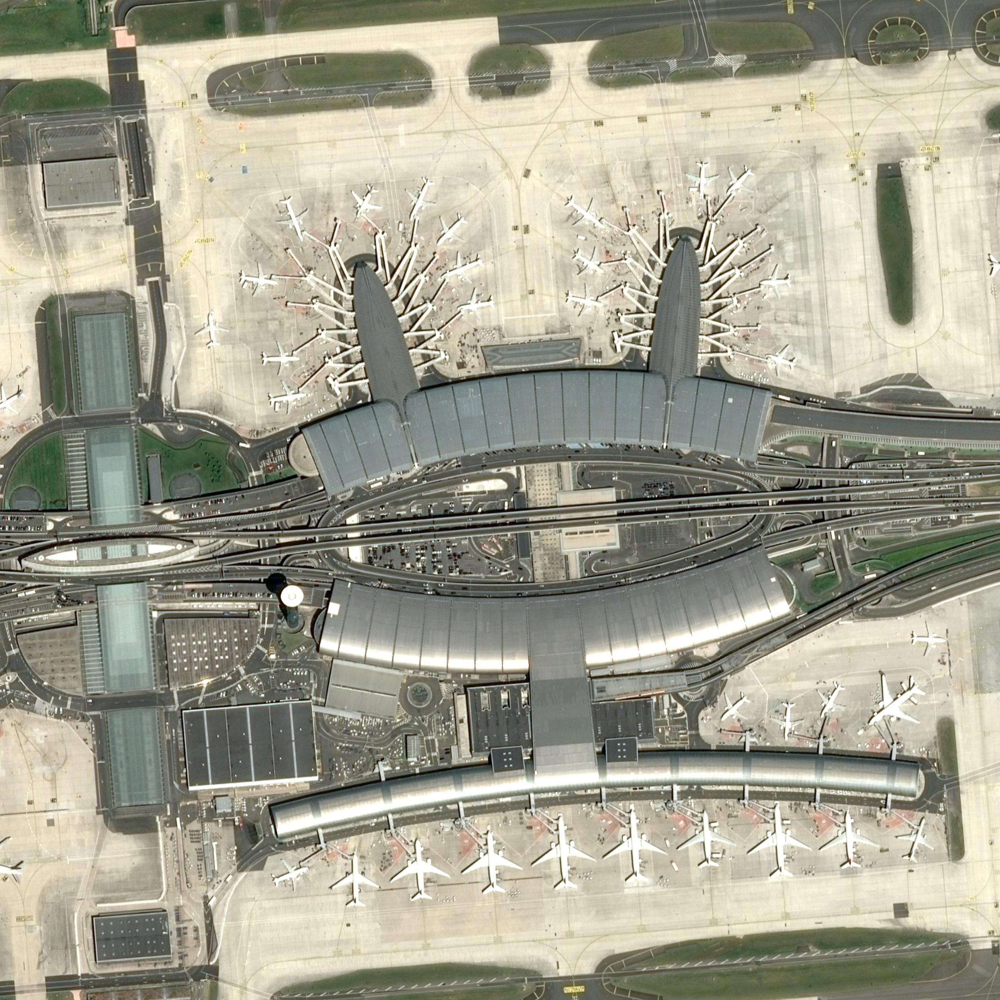

Sample tile: 4fdabd34-a2fd-4f0a-bb48-01fe043f1499.jpg | resolution: 2560x2560


In [19]:
img_list = sorted(DATASET_DIR.glob("images/*.jpg"))
sample_path = random.choice(img_list)
with Image.open(sample_path) as img:
    width, height = img.size

display.display(display.Image(filename=str(sample_path), embed=True))
print(f"Sample tile: {sample_path.name} | resolution: {width}x{height}")

## Annotation parsing

Load the CSV annotations, convert polygons to bounding boxes, and attach helper columns needed for EDA/training.


In [20]:
ANNOTATIONS_PATH = DATASET_DIR / "annotations.csv"

CLASS_NAME_MAP = {
    "Airplane": "Aircraft",
    "Truncated_airplane": "Truncated_Aircraft",
}
CLASS_TO_IDX = {"Background": 0, "Aircraft": 1, "Truncated_Aircraft": 2}
IDX_TO_CLASS = {idx: name for name, idx in CLASS_TO_IDX.items()}


def parse_geometry(raw_value: str) -> List[Tuple[float, float]]:
    return ast.literal_eval(raw_value.rstrip("\r\n"))


df = pd.read_csv(ANNOTATIONS_PATH, converters={"geometry": parse_geometry})


def polygon_to_bounds(polygon: List[Tuple[float, float]]) -> Tuple[float, float, float, float]:
    arr = np.array(polygon, dtype=np.float32)
    xs, ys = arr[:, 0], arr[:, 1]
    return float(xs.min()), float(ys.min()), float(xs.max()), float(ys.max())


df[["xmin", "ymin", "xmax", "ymax"]] = df["geometry"].apply(
    lambda poly: pd.Series(polygon_to_bounds(poly))
)

df["width"] = df["xmax"] - df["xmin"]
df["height"] = df["ymax"] - df["ymin"]
df["area"] = df["width"] * df["height"]
df["aspect_ratio"] = df["width"] / df["height"]
df["image_path"] = df["image_id"].apply(lambda x: DATASET_DIR / "images" / x)
df["class_name"] = df["class"].map(CLASS_NAME_MAP).fillna("Aircraft")
df["label_id"] = df["class_name"].map(CLASS_TO_IDX).astype(int)

display_df = df.head(5).copy()
display_df["image_path"] = display_df["image_path"].astype(str)
display_df


,id,image_id,geometry,class,xmin,ymin,xmax,ymax,width,height,area,aspect_ratio,image_path,class_name,label_id
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600...",Airplane,135.0,522.0,245.0,600.0,110.0,78.0,8580.0,1.410256,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025,...",Airplane,1025.0,284.0,1125.0,384.0,100.0,100.0,10000.0,1.000000,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (10...",Airplane,1058.0,1503.0,1130.0,1568.0,72.0,65.0,4680.0,1.107692,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
3,4,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(813, 1518), (885, 1518), (885, 1604), (813, ...",Airplane,813.0,1518.0,885.0,1604.0,72.0,86.0,6192.0,0.837209,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
4,5,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(594, 938), (657, 938), (657, 1012), (594, 10...",Airplane,594.0,938.0,657.0,1012.0,63.0,74.0,4662.0,0.851351,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1


## Exploratory data analysis

Understand how many aircraft exist per tile and how their bounding boxes are distributed before training.


,Unique tiles,Total boxes,Mean boxes/tile,Max boxes/tile,Min boxes/tile
0,103,3425,33.25,92,5


class_name
Aircraft              3316
Truncated_Aircraft     109
Name: count, dtype: int64

,image_id,median_width,median_height,median_area,box_count
85,d9399a45-6745-4e59-8903-90640b2ddf9f.jpg,96.0,101.0,9696.00,92
80,cbd51501-ed0f-411c-b472-df4357cca40c.jpg,67.5,67.0,4522.50,88
36,56e2d3d3-6b16-401f-a300-847272373df5.jpg,69.0,73.0,5037.00,71
34,54b4e42b-3667-4564-b8fa-c23122ca54d5.jpg,69.0,69.0,4761.00,67
60,980b5831-43b7-4adb-9e4b-67d6cff3ef68.jpg,69.0,78.0,5382.00,67
61,996ba764-cd2a-49c0-9c9f-b166207de0ab.jpg,89.5,70.5,6309.75,64
50,7635d63c-6b97-4c9c-a7dc-27773d42ed4c.jpg,110.5,129.5,14309.75,60
100,fc1ab8ce-e531-46ed-b74b-0374cd58cf2a.jpg,113.5,112.5,12768.75,58
45,696b9320-7dbe-4c28-bd07-7a73e7a28e64.jpg,77.5,83.5,6471.25,58
21,3e321b8a-9504-45aa-82b4-16158e28e290.jpg,80.0,83.0,6640.00,57


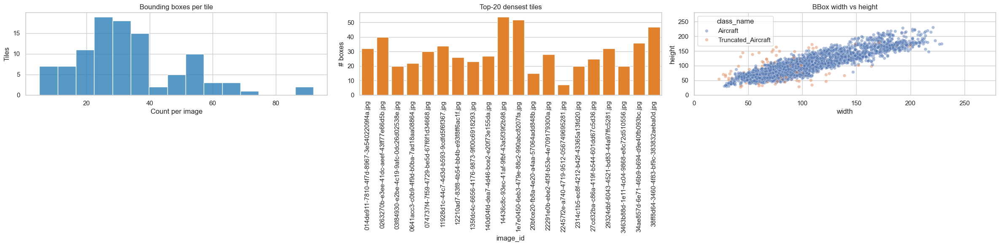

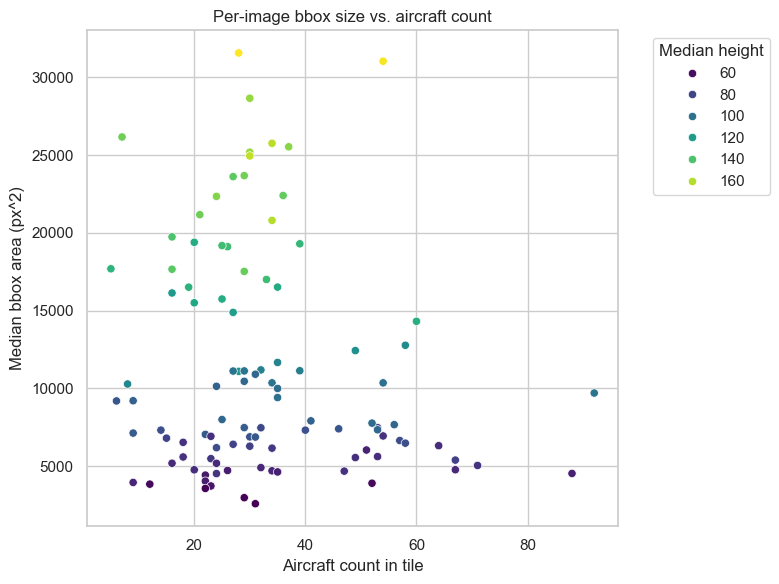

In [21]:
sns.set_theme(style="whitegrid")

num_images = df["image_id"].nunique()
boxes_per_image = df.groupby("image_id").size().astype(int)
class_distribution = df["class_name"].value_counts().rename("count")

summary_table = pd.DataFrame(
    {
        "Unique tiles": [num_images],
        "Total boxes": [len(df)],
        "Mean boxes/tile": [boxes_per_image.mean()],
        "Max boxes/tile": [boxes_per_image.max()],
        "Min boxes/tile": [boxes_per_image.min()],
    }
)
display.display(summary_table.round(2))

display.display(class_distribution)

per_image_box_stats = (
    df.groupby("image_id")
    .agg(
        box_count=("id", "count"),
        min_width=("width", "min"),
        median_width=("width", "median"),
        max_width=("width", "max"),
        min_height=("height", "min"),
        median_height=("height", "median"),
        max_height=("height", "max"),
    )
    .reset_index()
)
per_image_box_stats["median_area"] = per_image_box_stats["median_width"] * per_image_box_stats["median_height"]

fig, axes = plt.subplots(1, 3, figsize=(24, 6))
sns.histplot(boxes_per_image, bins=15, ax=axes[0], color="#1f77b4")
axes[0].set_title("Bounding boxes per tile")
axes[0].set_xlabel("Count per image")
axes[0].set_ylabel("Tiles")

head_counts = boxes_per_image.head(20)
sns.barplot(x=head_counts.index, y=head_counts.values, ax=axes[1], color="#ff7f0e")
axes[1].set_title("Top-20 densest tiles")
axes[1].set_xlabel("image_id")
axes[1].tick_params(axis="x", rotation=90)
axes[1].set_ylabel("# boxes")

sns.scatterplot(
    data=df,
    x="width",
    y="height",
    hue="class_name",
    ax=axes[2],
    alpha=0.45,
    s=30,
)
axes[2].set_title("BBox width vs height")
axes[2].set_xlim(0, df["width"].max() + 50)
axes[2].set_ylim(0, df["height"].max() + 50)
plt.tight_layout()

per_image_melt = per_image_box_stats[["image_id", "median_width", "median_height", "median_area", "box_count"]].copy()
per_image_melt.sort_values("box_count", ascending=False, inplace=True)
display.display(per_image_melt.head(10))

plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=per_image_box_stats,
    x="box_count",
    y="median_area",
    hue="median_height",
    palette="viridis",
)
plt.title("Per-image bbox size vs. aircraft count")
plt.xlabel("Aircraft count in tile")
plt.ylabel("Median bbox area (px^2)")
plt.legend(title="Median height", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()


## AlexNet backbone diagnostics

Instantiate a fresh AlexNet feature extractor, count its parameters, and trace the tensor shapes flowing through each major layer to double-check the architecture.


## Helper utilities for the training pipeline

Reusable dataset, augmentation, metric, and training helpers live in this section so the later notebook cells can stay focused on orchestration.


In [22]:
# --- Dataset + utility structures -------------------------------------------------

@dataclass
class AnnotationRecord:
    """Container for all annotations belonging to one satellite tile."""

    image_id: str
    image_path: Path
    boxes: np.ndarray
    labels: np.ndarray
    class_names: List[str]


def build_annotation_records(frame: pd.DataFrame) -> Dict[str, AnnotationRecord]:
    records: Dict[str, AnnotationRecord] = {}
    for image_id, group in frame.groupby("image_id"):
        boxes = group[["xmin", "ymin", "xmax", "ymax"]].values.astype(np.float32)
        labels = group["label_id"].values.astype(np.int64)
        class_names = group["class_name"].tolist()
        image_path = Path(group["image_path"].iloc[0])
        records[image_id] = AnnotationRecord(
            image_id=image_id,
            image_path=image_path,
            boxes=boxes,
            labels=labels,
            class_names=class_names,
        )
    return records


def split_image_ids(
    image_ids: Sequence[str], val_ratio: float = 0.15, test_ratio: float = 0.15, seed: int = 42
) -> Dict[str, List[str]]:
    rng = np.random.default_rng(seed)
    image_ids = np.array(image_ids)
    rng.shuffle(image_ids)
    n_total = len(image_ids)
    n_test = int(n_total * test_ratio)
    n_val = int(n_total * val_ratio)
    test_ids = image_ids[:n_test].tolist()
    val_ids = image_ids[n_test : n_test + n_val].tolist()
    train_ids = image_ids[n_test + n_val :].tolist()
    return {"train": train_ids, "val": val_ids, "test": test_ids}


ALEXNET_WEIGHTS = AlexNet_Weights.IMAGENET1K_V1
ALEXNET_MEAN = ALEXNET_WEIGHTS.transforms().mean
ALEXNET_STD = ALEXNET_WEIGHTS.transforms().std

CLASSIFIER_BACKBONE_WEIGHTS = Path("artifacts") / "alexnet_classifier_weights.pth"
if not CLASSIFIER_BACKBONE_WEIGHTS.exists():
    raise FileNotFoundError(
        f"Expected classifier weights at {CLASSIFIER_BACKBONE_WEIGHTS.resolve()}"
    )


class AirbusDetectionDataset(Dataset):
    """PyTorch dataset that reads Airbus tiles and formats targets for Faster R-CNN."""

    def __init__(
        self,
        records: Dict[str, AnnotationRecord],
        image_ids: Sequence[str],
        image_size: int = 1024,
        is_train: bool = False,
        hflip_prob: float = 0.5,
    ) -> None:
        self.records = records
        self.image_ids = list(image_ids)
        self.image_size = image_size
        self.is_train = is_train
        self.hflip_prob = hflip_prob

    def __len__(self) -> int:
        return len(self.image_ids)

    def _load_image(self, record: AnnotationRecord) -> Image.Image:
        return Image.open(record.image_path).convert("RGB")

    def _resize_boxes(
        self, boxes: torch.Tensor, orig_size: Tuple[int, int], new_size: int
    ) -> torch.Tensor:
        orig_w, orig_h = orig_size
        scale_x = new_size / orig_w
        scale_y = new_size / orig_h
        boxes = boxes.clone()
        boxes[:, [0, 2]] *= scale_x
        boxes[:, [1, 3]] *= scale_y
        return boxes

    def _random_horizontal_flip(
        self, image: Image.Image, boxes: torch.Tensor
    ) -> Tuple[Image.Image, torch.Tensor]:
        if not self.is_train or random.random() > self.hflip_prob:
            return image, boxes
        flipped = image.transpose(Image.FLIP_LEFT_RIGHT)
        img_w = image.width
        boxes = boxes.clone()
        xmin = img_w - boxes[:, 2]
        xmax = img_w - boxes[:, 0]
        boxes[:, 0], boxes[:, 2] = xmin, xmax
        return flipped, boxes

    def __getitem__(self, idx: int) -> Tuple[torch.Tensor, Dict[str, torch.Tensor]]:
        record = self.records[self.image_ids[idx]]
        image = self._load_image(record)
        orig_w, orig_h = image.size

        boxes = torch.as_tensor(record.boxes, dtype=torch.float32)
        labels = torch.as_tensor(record.labels, dtype=torch.int64)

        if self.image_size:
            image = image.resize((self.image_size, self.image_size), Image.BILINEAR)
            boxes = self._resize_boxes(boxes, (orig_w, orig_h), self.image_size)

        image, boxes = self._random_horizontal_flip(image, boxes)

        tensor_image = F.to_tensor(image)
        tensor_image = F.normalize(tensor_image, mean=ALEXNET_MEAN, std=ALEXNET_STD)

        target: Dict[str, torch.Tensor] = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([idx], dtype=torch.int64),
            "area": (boxes[:, 2] - boxes[:, 0]) * (boxes[:, 3] - boxes[:, 1]),
            "iscrowd": torch.zeros((len(boxes),), dtype=torch.int64),
            "orig_size": torch.tensor([orig_h, orig_w]),
        }
        return tensor_image, target


def detection_collate(batch: Sequence[Tuple[torch.Tensor, Dict[str, torch.Tensor]]]):
    images, targets = zip(*batch)
    return list(images), list(targets)


# --- Training/evaluation helpers -------------------------------------------------

def seed_everything(seed: int = 42) -> None:
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)


class AverageMeter:
    """Track running averages for training losses."""

    def __init__(self) -> None:
        self.reset()

    def reset(self) -> None:
        self.count = 0
        self.total = 0.0

    def update(self, value: float, n: int = 1) -> None:
        self.total += value * n
        self.count += n

    @property
    def avg(self) -> float:
        return self.total / max(self.count, 1)


class EarlyStopping:
    def __init__(self, patience: int = 3, delta: float = 0.0) -> None:
        self.patience = patience
        self.delta = delta
        self.best_score: Optional[float] = None
        self.bad_epochs = 0

    def step(self, metric: float) -> bool:
        if self.best_score is None or metric > self.best_score + self.delta:
            self.best_score = metric
            self.bad_epochs = 0
            return False
        self.bad_epochs += 1
        return self.bad_epochs > self.patience


class CheckpointManager:
    def __init__(self, path: Path) -> None:
        self.path = path

    def save(self, model_state: Dict[str, Any], optimizer_state: Dict[str, Any], epoch: int, metric: float) -> None:
        torch.save(
            {
                "epoch": epoch,
                "metric": metric,
                "model_state": model_state,
                "optimizer_state": optimizer_state,
            },
            self.path,
        )


class HistoryLogger:
    def __init__(self) -> None:
        self.rows: List[Dict[str, float]] = []

    def log(self, **kwargs: float) -> None:
        self.rows.append(kwargs)

    def to_frame(self) -> pd.DataFrame:
        return pd.DataFrame(self.rows)


def train_one_epoch(
    model: nn.Module,
    loader: DataLoader,
    optimizer: torch.optim.Optimizer,
    device: torch.device,
) -> float:
    model.train()
    loss_meter = AverageMeter()
    for images, targets in tqdm(loader, desc="Train", leave=False):
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss_dict.values())

        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        optimizer.step()

        loss_meter.update(loss.item(), n=len(images))
    return loss_meter.avg


def validate_one_epoch(
    model: nn.Module,
    loader: DataLoader,
    device: torch.device,
) -> float:
    prev_state = model.training
    model.train()
    loss_meter = AverageMeter()
    with torch.no_grad():
        for images, targets in tqdm(loader, desc="Val", leave=False):
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]
            loss_dict = model(images, targets)
            loss = sum(loss_dict.values())
            loss_meter.update(loss.item(), n=len(images))
    model.train(prev_state)
    return loss_meter.avg


# --- Metric helpers --------------------------------------------------------------

def average_precision_50(
    pred_boxes: torch.Tensor,
    pred_scores: torch.Tensor,
    gt_boxes: torch.Tensor,
    iou_threshold: float = 0.5,
) -> float:
    if gt_boxes.numel() == 0:
        return 1.0 if pred_boxes.numel() == 0 else 0.0
    if pred_boxes.numel() == 0:
        return 0.0

    order = torch.argsort(pred_scores, descending=True)
    pred_boxes = pred_boxes[order]
    pred_scores = pred_scores[order]

    ious = box_iou(pred_boxes, gt_boxes)
    gt_matched = torch.zeros(len(gt_boxes), dtype=torch.bool)

    tps = []
    fps = []
    for pred_idx in range(len(pred_boxes)):
        iou_vals = ious[pred_idx]
        best_iou, best_gt = torch.max(iou_vals, dim=0)
        if best_iou >= iou_threshold and not gt_matched[best_gt]:
            gt_matched[best_gt] = True
            tps.append(1)
            fps.append(0)
        else:
            tps.append(0)
            fps.append(1)

    tps = np.cumsum(tps)
    fps = np.cumsum(fps)
    precisions = tps / np.maximum(tps + fps, 1e-6)
    recalls = tps / len(gt_boxes)
    ap = np.trapezoid(precisions, recalls)
    return float(ap)


def evaluate_detector(
    model: nn.Module,
    loader: DataLoader,
    device: torch.device,
    score_threshold: float = 0.4,
    iou_threshold: float = 0.5,
) -> Dict[str, float]:
    prev_state = model.training
    model.eval()
    aps = []
    precisions = []
    recalls = []
    detections_per_img: List[int] = []
    kept_score_means: List[float] = []
    with torch.no_grad():
        for images, targets in tqdm(loader, desc="Eval", leave=False):
            images = [img.to(device) for img in images]
            outputs = model(images)
            for output, target in zip(outputs, targets):
                keep = output["scores"] >= score_threshold
                kept_count = int(keep.sum().item())
                detections_per_img.append(kept_count)

                kept_boxes = output["boxes"][keep]
                kept_scores = output["scores"][keep]
                if kept_scores.numel():
                    kept_score_means.append(float(kept_scores.mean().item()))

                pred_boxes = kept_boxes.cpu()
                pred_scores = kept_scores.cpu()
                gt_boxes = target["boxes"].cpu()
                ap = average_precision_50(pred_boxes, pred_scores, gt_boxes, iou_threshold)
                aps.append(ap)

                ious = box_iou(pred_boxes, gt_boxes) if pred_boxes.numel() and gt_boxes.numel() else torch.zeros((len(pred_boxes), len(gt_boxes)))
                matches = (ious >= iou_threshold).any(dim=1).sum().item() if gt_boxes.numel() else 0
                precisions.append(matches / max(len(pred_boxes), 1))
                recalls.append(matches / max(len(gt_boxes), 1))
    model.train(prev_state)
    num_images = len(detections_per_img)
    detection_coverage = (
        sum(1 for count in detections_per_img if count > 0) / num_images if num_images else 0.0
    )
    avg_detections = float(np.mean(detections_per_img)) if detections_per_img else 0.0
    mean_score = float(np.mean(kept_score_means)) if kept_score_means else 0.0
    return {
        "mAP@0.5": float(np.mean(aps)) if aps else 0.0,
        "precision": float(np.mean(precisions)) if precisions else 0.0,
        "recall": float(np.mean(recalls)) if recalls else 0.0,
        "detections_per_image": avg_detections,
        "detection_coverage": detection_coverage,
        "mean_score": mean_score,
    }



In [23]:
temp_backbone = ClassicAlexNetBackbone(trainable_layers=2)
total_params = sum(p.numel() for p in temp_backbone.parameters())
trainable_params = sum(p.numel() for p in temp_backbone.parameters() if p.requires_grad)
print(f"Total parameters: {total_params:,}")
print(f"Trainable parameters: {trainable_params:,}")

layer_shapes: List[Dict[str, Any]] = []
hooks = []
TEST_INPUT_RES = 512


def record_hook(name: str):
    def hook(module, inputs, output):
        if isinstance(output, torch.Tensor):
            shape = tuple(output.shape)
        elif isinstance(output, (list, tuple)):
            shape = [tuple(o.shape) for o in output if isinstance(o, torch.Tensor)]
        else:
            shape = type(output).__name__
        layer_shapes.append({"layer": name, "type": module.__class__.__name__, "output_shape": shape})

    return hook


for name, module in temp_backbone.named_modules():
    if name and isinstance(module, (nn.Conv2d, nn.MaxPool2d, nn.AdaptiveAvgPool2d, nn.ReLU)):
        hooks.append(module.register_forward_hook(record_hook(name)))

with torch.no_grad():
    dummy = torch.zeros(1, 3, TEST_INPUT_RES, TEST_INPUT_RES)
    _ = temp_backbone(dummy)

for hook in hooks:
    hook.remove()

summary_df = pd.DataFrame(layer_shapes)
display.display(summary_df)



Total parameters: 3,747,200
Trainable parameters: 2,212,480


,layer,type,output_shape
0,blocks.0.0,Conv2d,"(1, 96, 127, 127)"
1,blocks.0.1,ReLU,"(1, 96, 127, 127)"
2,blocks.0.2,MaxPool2d,"(1, 96, 63, 63)"
3,blocks.1.0,Conv2d,"(1, 256, 63, 63)"
4,blocks.1.1,ReLU,"(1, 256, 63, 63)"
5,blocks.1.2,MaxPool2d,"(1, 256, 31, 31)"
6,blocks.2.0,Conv2d,"(1, 384, 31, 31)"
7,blocks.2.1,ReLU,"(1, 384, 31, 31)"
8,blocks.3.0,Conv2d,"(1, 384, 31, 31)"
9,blocks.3.1,ReLU,"(1, 384, 31, 31)"


## Train/validation/test splits and loaders

Create per-image records, stratify them into splits, and wrap everything with PyTorch dataloaders.


In [24]:
seed_everything(42)

records = build_annotation_records(df)
image_ids = sorted(records.keys())
splits = split_image_ids(image_ids, val_ratio=0.2, test_ratio=0.1, seed=42)

IMAGE_SIZE = 1024
BATCH_SIZE = 2
NUM_WORKERS = 0

train_dataset = AirbusDetectionDataset(records, splits["train"], image_size=IMAGE_SIZE, is_train=True)
val_dataset = AirbusDetectionDataset(records, splits["val"], image_size=IMAGE_SIZE, is_train=False)
test_dataset = AirbusDetectionDataset(records, splits["test"], image_size=IMAGE_SIZE, is_train=False)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    collate_fn=detection_collate,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    collate_fn=detection_collate,
)
test_loader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=False,
    num_workers=NUM_WORKERS,
    collate_fn=detection_collate,
)

split_summary = {
    split: {
        "tiles": len(ids),
        "boxes": sum(len(records[i].boxes) for i in ids),
    }
    for split, ids in splits.items()
}
pd.DataFrame(split_summary).T


,tiles,boxes
train,73,2429
val,20,691
test,10,305


## Training the AlexNet detector with Optuna

Use Optuna to explore optimizer settings (learning rate, weight decay, optimizer type), train for a handful of epochs with early stopping, and log/visualize the history.


In [ ]:
if torch.cuda.is_available():
    device = torch.device("cuda")
elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"Using device: {device}")

MAX_EPOCHS = 20
N_TRIALS = 5
PATIENCE = 6
TRAINABLE_BACKBONE_LAYERS = 4 # was 2
EVAL_SCORE_THRESHOLD = 0.23  # relaxed threshold so early epochs still log signal was 0.15
ARTIFACT_DIR = Path("artifacts")
ARTIFACT_DIR.mkdir(parents=True, exist_ok=True)
BEST_MODEL_PATH = ARTIFACT_DIR / "alexnet_custom_detector_best.pth"

best_trial_store = {"metric": -np.inf, "history": None, "params": None}


def build_model_instance() -> nn.Module:
    return build_custom_alexnet_detector(
        num_classes=len(CLASS_TO_IDX),
        classifier_weights=CLASSIFIER_BACKBONE_WEIGHTS,
        freeze_backbone=False,
        trainable_layers=TRAINABLE_BACKBONE_LAYERS,
    )


def build_param_groups(
    model: nn.Module,
    base_lr: float,
    head_lr_multiplier: float,
    backbone_lr_multiplier: float,
) -> List[Dict[str, Any]]:
    head_params: List[torch.nn.Parameter] = []
    backbone_params: List[torch.nn.Parameter] = []
    other_params: List[torch.nn.Parameter] = []
    for name, param in model.named_parameters():
        if not param.requires_grad:
            continue
        if name.startswith(("roi_heads", "rpn")):
            head_params.append(param)
        elif name.startswith("backbone"):
            backbone_params.append(param)
        else:
            other_params.append(param)

    param_groups: List[Dict[str, Any]] = []
    if other_params:
        param_groups.append({"params": other_params})
    if backbone_params:
        param_groups.append({"params": backbone_params, "lr": base_lr * backbone_lr_multiplier})
    if head_params:
        param_groups.append({"params": head_params, "lr": base_lr * head_lr_multiplier})
    if not param_groups:
        raise ValueError("No trainable parameters found for optimizer.")
    return param_groups


def make_optimizer(trial: optuna.Trial, model: nn.Module) -> torch.optim.Optimizer:
    lr = trial.suggest_float("lr", 1e-4, 1e-3, log=True) # was 3e-6, 1e-3
    weight_decay = trial.suggest_float("weight_decay", 1e-6, 5e-4, log=True) # was 1e-6, 1e-2 : 1e-6, 1e-3
    head_lr_multiplier = trial.suggest_float("head_lr_multiplier", 1.5, 5) # was 1.0, 5.0
    backbone_lr_multiplier = trial.suggest_float("backbone_lr_multiplier", 0.05, 0.4) # was 0.05, 0.5
    param_groups = build_param_groups(model, lr, head_lr_multiplier, backbone_lr_multiplier)
    
    return torch.optim.AdamW(param_groups, lr=lr, weight_decay=weight_decay)


def objective(trial: optuna.Trial) -> float:
    model = build_model_instance().to(device)
    optimizer = make_optimizer(trial, model)
    early_stopper = EarlyStopping(patience=PATIENCE, delta=1e-3)
    history = HistoryLogger()
    checkpoint_path = ARTIFACT_DIR / f"trial_{trial.number}_best.pth"
    history_path = ARTIFACT_DIR / f"trial_{trial.number}_history.csv"
    checkpoint = CheckpointManager(checkpoint_path)
    best_metric = -np.inf

    for epoch in range(1, MAX_EPOCHS + 1):
        train_loss = train_one_epoch(model, train_loader, optimizer, device)
        val_loss = validate_one_epoch(model, val_loader, device)
        val_metrics = evaluate_detector(
            model,
            val_loader,
            device,
            score_threshold=EVAL_SCORE_THRESHOLD,
        )
        metric = val_metrics["mAP@0.5"]

        history.log(
            epoch=epoch,
            train_loss=train_loss,
            val_loss=val_loss,
            map50=val_metrics["mAP@0.5"],
            precision=val_metrics["precision"],
            recall=val_metrics["recall"],
            detections_per_image=val_metrics["detections_per_image"],
            detection_coverage=val_metrics["detection_coverage"],
            mean_score=val_metrics["mean_score"],
        )

        print(
            f"[trial {trial.number}] epoch {epoch:02d}/{MAX_EPOCHS} "
            f"train_loss={train_loss:.3f} val_loss={val_loss:.3f} "
            f"map50={val_metrics['mAP@0.5']:.3f} precision={val_metrics['precision']:.3f} "
            f"recall={val_metrics['recall']:.3f} dets/img={val_metrics['detections_per_image']:.2f} "
            f"coverage={val_metrics['detection_coverage']*100:.1f}% score={val_metrics['mean_score']:.3f}",
            flush=True,
        )

        if metric > best_metric:
            best_metric = metric
            checkpoint.save(model.state_dict(), optimizer.state_dict(), epoch, metric)

        trial.report(metric, epoch)
        if trial.should_prune():
            raise optuna.TrialPruned()

        if early_stopper.step(metric):
            print(f"Early stopping triggered on epoch {epoch}")
            break

    history_df = history.to_frame()
    history_df.to_csv(history_path, index=False)

    global best_trial_store
    if best_metric > best_trial_store["metric"]:
        best_trial_store["metric"] = best_metric
        best_trial_store["history"] = history_df
        best_trial_store["params"] = trial.params
        shutil.copy(checkpoint_path, BEST_MODEL_PATH)

    return best_metric


study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=N_TRIALS)

print("Best trial:", study.best_trial.number)
print("Best params:", study.best_params)
print("Best mAP@0.5:", study.best_value)

best_history_df = best_trial_store["history"] if best_trial_store["history"] is not None else pd.DataFrame()
best_history_df


[I 2025-11-28 20:00:07,035] A new study created in memory with name: no-name-4762f2b7-8525-442d-a4bf-49dbc43ed495


Using device: cuda


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 01/20 train_loss=1.218 val_loss=1.041 map50=0.002 precision=0.018 recall=0.040 dets/img=68.15 coverage=100.0% score=0.326


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 02/20 train_loss=0.831 val_loss=0.867 map50=0.005 precision=0.020 recall=0.050 dets/img=80.50 coverage=100.0% score=0.308


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 03/20 train_loss=0.726 val_loss=0.916 map50=0.006 precision=0.076 recall=0.035 dets/img=22.05 coverage=90.0% score=0.283


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 04/20 train_loss=0.735 val_loss=0.837 map50=0.011 precision=0.049 recall=0.063 dets/img=44.75 coverage=95.0% score=0.277


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 05/20 train_loss=0.736 val_loss=0.800 map50=0.013 precision=0.058 recall=0.064 dets/img=35.00 coverage=100.0% score=0.284


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 06/20 train_loss=0.727 val_loss=0.808 map50=0.020 precision=0.049 recall=0.104 dets/img=63.20 coverage=100.0% score=0.285


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 07/20 train_loss=0.750 val_loss=0.820 map50=0.020 precision=0.055 recall=0.161 dets/img=85.25 coverage=100.0% score=0.364


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 08/20 train_loss=0.743 val_loss=0.902 map50=0.004 precision=0.125 recall=0.021 dets/img=6.90 coverage=80.0% score=0.309


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 09/20 train_loss=0.735 val_loss=0.842 map50=0.018 precision=0.062 recall=0.104 dets/img=46.25 coverage=95.0% score=0.320


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 10/20 train_loss=0.740 val_loss=0.832 map50=0.024 precision=0.077 recall=0.112 dets/img=47.75 coverage=100.0% score=0.328


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 11/20 train_loss=0.745 val_loss=0.851 map50=0.026 precision=0.065 recall=0.188 dets/img=86.95 coverage=100.0% score=0.404


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 12/20 train_loss=0.721 val_loss=0.862 map50=0.028 precision=0.077 recall=0.135 dets/img=47.15 coverage=95.0% score=0.350


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 13/20 train_loss=0.756 val_loss=0.879 map50=0.037 precision=0.086 recall=0.201 dets/img=77.65 coverage=100.0% score=0.354


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 14/20 train_loss=0.751 val_loss=0.860 map50=0.041 precision=0.076 recall=0.195 dets/img=77.55 coverage=100.0% score=0.360


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 15/20 train_loss=0.753 val_loss=0.882 map50=0.043 precision=0.082 recall=0.202 dets/img=75.90 coverage=100.0% score=0.394


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 16/20 train_loss=0.751 val_loss=0.855 map50=0.040 precision=0.113 recall=0.169 dets/img=43.35 coverage=100.0% score=0.373


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 17/20 train_loss=0.742 val_loss=0.850 map50=0.043 precision=0.077 recall=0.195 dets/img=74.70 coverage=100.0% score=0.366


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 18/20 train_loss=0.732 val_loss=0.877 map50=0.049 precision=0.107 recall=0.198 dets/img=54.95 coverage=100.0% score=0.368


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 19/20 train_loss=0.742 val_loss=0.876 map50=0.044 precision=0.072 recall=0.179 dets/img=73.20 coverage=100.0% score=0.379


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 20/20 train_loss=0.748 val_loss=0.890 map50=0.059 precision=0.094 recall=0.250 dets/img=79.50 coverage=100.0% score=0.394


[I 2025-11-28 20:03:33,473] Trial 0 finished with value: 0.05941375824873463 and parameters: {'lr': 0.00020199444317229562, 'weight_decay': 1.2874891026635913e-06, 'head_lr_multiplier': 2.5410631110144006, 'backbone_lr_multiplier': 0.058202975593972694}. Best is trial 0 with value: 0.05941375824873463.


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 01/20 train_loss=1.229 val_loss=1.053 map50=0.003 precision=0.019 recall=0.040 dets/img=60.35 coverage=95.0% score=0.336


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 02/20 train_loss=0.813 val_loss=0.845 map50=0.003 precision=0.024 recall=0.045 dets/img=58.20 coverage=95.0% score=0.275


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 03/20 train_loss=0.725 val_loss=0.787 map50=0.005 precision=0.040 recall=0.044 dets/img=57.60 coverage=95.0% score=0.280


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 04/20 train_loss=0.729 val_loss=0.796 map50=0.010 precision=0.044 recall=0.077 dets/img=59.00 coverage=95.0% score=0.317


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 05/20 train_loss=0.729 val_loss=0.792 map50=0.015 precision=0.049 recall=0.138 dets/img=90.50 coverage=100.0% score=0.354


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 06/20 train_loss=0.736 val_loss=0.818 map50=0.026 precision=0.054 recall=0.169 dets/img=91.20 coverage=100.0% score=0.395


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 07/20 train_loss=0.761 val_loss=0.830 map50=0.031 precision=0.097 recall=0.172 dets/img=68.05 coverage=95.0% score=0.322


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 08/20 train_loss=0.749 val_loss=0.799 map50=0.027 precision=0.104 recall=0.100 dets/img=37.80 coverage=95.0% score=0.320


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 09/20 train_loss=0.729 val_loss=0.818 map50=0.042 precision=0.096 recall=0.193 dets/img=72.20 coverage=100.0% score=0.340


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 10/20 train_loss=0.749 val_loss=0.849 map50=0.063 precision=0.087 recall=0.292 dets/img=99.30 coverage=100.0% score=0.408


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 11/20 train_loss=0.738 val_loss=0.847 map50=0.055 precision=0.128 recall=0.241 dets/img=56.70 coverage=100.0% score=0.364


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 12/20 train_loss=0.772 val_loss=0.835 map50=0.048 precision=0.138 recall=0.194 dets/img=49.10 coverage=100.0% score=0.346


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 13/20 train_loss=0.730 val_loss=0.844 map50=0.071 precision=0.117 recall=0.322 dets/img=83.70 coverage=100.0% score=0.406


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 14/20 train_loss=0.740 val_loss=0.865 map50=0.073 precision=0.121 recall=0.293 dets/img=79.20 coverage=100.0% score=0.369


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 15/20 train_loss=0.738 val_loss=0.856 map50=0.069 precision=0.107 recall=0.306 dets/img=87.15 coverage=100.0% score=0.420


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 16/20 train_loss=0.733 val_loss=0.825 map50=0.085 precision=0.120 recall=0.339 dets/img=89.80 coverage=100.0% score=0.414


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 17/20 train_loss=0.729 val_loss=0.866 map50=0.092 precision=0.130 recall=0.351 dets/img=84.30 coverage=100.0% score=0.396


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 18/20 train_loss=0.720 val_loss=0.909 map50=0.099 precision=0.141 recall=0.401 dets/img=86.65 coverage=100.0% score=0.539


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 19/20 train_loss=0.740 val_loss=0.901 map50=0.088 precision=0.156 recall=0.339 dets/img=71.70 coverage=100.0% score=0.433


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 20/20 train_loss=0.715 val_loss=0.908 map50=0.102 precision=0.158 recall=0.408 dets/img=82.00 coverage=100.0% score=0.458


[I 2025-11-28 20:07:01,045] Trial 1 finished with value: 0.10220392143567529 and parameters: {'lr': 0.00016217239805878098, 'weight_decay': 2.320894351569812e-06, 'head_lr_multiplier': 2.4909984621897596, 'backbone_lr_multiplier': 0.3139704401962427}. Best is trial 1 with value: 0.10220392143567529.


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 01/20 train_loss=1.255 val_loss=0.974 map50=0.003 precision=0.013 recall=0.041 dets/img=80.70 coverage=100.0% score=0.330


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 02/20 train_loss=0.813 val_loss=0.853 map50=0.006 precision=0.036 recall=0.040 dets/img=49.40 coverage=100.0% score=0.276


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 03/20 train_loss=0.736 val_loss=0.875 map50=0.007 precision=0.031 recall=0.055 dets/img=59.75 coverage=90.0% score=0.300


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 04/20 train_loss=0.744 val_loss=0.815 map50=0.015 precision=0.036 recall=0.097 dets/img=76.20 coverage=100.0% score=0.321


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 05/20 train_loss=0.734 val_loss=0.785 map50=0.007 precision=0.068 recall=0.042 dets/img=27.55 coverage=95.0% score=0.269


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 06/20 train_loss=0.730 val_loss=0.821 map50=0.014 precision=0.048 recall=0.132 dets/img=84.35 coverage=100.0% score=0.343


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 07/20 train_loss=0.742 val_loss=0.785 map50=0.015 precision=0.049 recall=0.123 dets/img=75.85 coverage=100.0% score=0.343


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 08/20 train_loss=0.713 val_loss=0.817 map50=0.016 precision=0.071 recall=0.127 dets/img=61.00 coverage=100.0% score=0.315


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 09/20 train_loss=0.744 val_loss=0.873 map50=0.024 precision=0.066 recall=0.165 dets/img=78.50 coverage=100.0% score=0.356


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 10/20 train_loss=0.752 val_loss=0.822 map50=0.029 precision=0.083 recall=0.147 dets/img=53.75 coverage=95.0% score=0.328


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 11/20 train_loss=0.744 val_loss=0.825 map50=0.035 precision=0.070 recall=0.177 dets/img=73.25 coverage=100.0% score=0.350


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 12/20 train_loss=0.734 val_loss=0.862 map50=0.042 precision=0.110 recall=0.184 dets/img=50.75 coverage=100.0% score=0.352


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 13/20 train_loss=0.758 val_loss=0.835 map50=0.049 precision=0.084 recall=0.199 dets/img=77.75 coverage=100.0% score=0.354


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 14/20 train_loss=0.755 val_loss=0.860 map50=0.043 precision=0.103 recall=0.195 dets/img=58.50 coverage=100.0% score=0.355


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 15/20 train_loss=0.762 val_loss=0.838 map50=0.052 precision=0.088 recall=0.231 dets/img=85.75 coverage=100.0% score=0.421


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 16/20 train_loss=0.751 val_loss=0.856 map50=0.053 precision=0.093 recall=0.202 dets/img=67.85 coverage=100.0% score=0.354


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 17/20 train_loss=0.752 val_loss=0.882 map50=0.059 precision=0.096 recall=0.251 dets/img=80.95 coverage=100.0% score=0.450


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 18/20 train_loss=0.748 val_loss=0.831 map50=0.056 precision=0.092 recall=0.219 dets/img=73.65 coverage=100.0% score=0.366


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 19/20 train_loss=0.749 val_loss=0.834 map50=0.057 precision=0.097 recall=0.204 dets/img=64.85 coverage=100.0% score=0.356


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 20/20 train_loss=0.751 val_loss=0.934 map50=0.067 precision=0.126 recall=0.206 dets/img=51.70 coverage=100.0% score=0.370


[I 2025-11-28 20:10:28,819] Trial 2 finished with value: 0.06713839107315225 and parameters: {'lr': 0.00014553036539514104, 'weight_decay': 6.507632965580202e-06, 'head_lr_multiplier': 3.6862779123028586, 'backbone_lr_multiplier': 0.12043405217352343}. Best is trial 1 with value: 0.10220392143567529.


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 01/20 train_loss=1.082 val_loss=0.956 map50=0.001 precision=0.018 recall=0.027 dets/img=46.50 coverage=100.0% score=0.269


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 02/20 train_loss=0.774 val_loss=0.870 map50=0.006 precision=0.034 recall=0.062 dets/img=61.20 coverage=95.0% score=0.281


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 03/20 train_loss=0.760 val_loss=0.848 map50=0.018 precision=0.075 recall=0.113 dets/img=65.10 coverage=100.0% score=0.297


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 04/20 train_loss=0.756 val_loss=0.873 map50=0.017 precision=0.081 recall=0.127 dets/img=56.35 coverage=100.0% score=0.313


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 05/20 train_loss=0.788 val_loss=0.873 map50=0.030 precision=0.075 recall=0.178 dets/img=67.90 coverage=100.0% score=0.346


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 06/20 train_loss=0.790 val_loss=0.867 map50=0.035 precision=0.117 recall=0.159 dets/img=40.05 coverage=100.0% score=0.324


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 07/20 train_loss=0.797 val_loss=0.906 map50=0.050 precision=0.116 recall=0.237 dets/img=57.85 coverage=100.0% score=0.390


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 08/20 train_loss=0.785 val_loss=0.886 map50=0.046 precision=0.102 recall=0.282 dets/img=79.10 coverage=100.0% score=0.459


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 09/20 train_loss=0.808 val_loss=0.878 map50=0.071 precision=0.117 recall=0.352 dets/img=91.70 coverage=100.0% score=0.439


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 10/20 train_loss=0.790 val_loss=0.915 map50=0.068 precision=0.134 recall=0.267 dets/img=58.90 coverage=100.0% score=0.378


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 11/20 train_loss=0.783 val_loss=0.943 map50=0.085 precision=0.134 recall=0.347 dets/img=78.45 coverage=100.0% score=0.407


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 12/20 train_loss=0.785 val_loss=0.921 map50=0.100 precision=0.136 recall=0.391 dets/img=89.70 coverage=100.0% score=0.441


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 13/20 train_loss=0.785 val_loss=0.934 map50=0.087 precision=0.134 recall=0.367 dets/img=84.80 coverage=100.0% score=0.423


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 14/20 train_loss=0.743 val_loss=0.924 map50=0.094 precision=0.133 recall=0.369 dets/img=86.70 coverage=100.0% score=0.429


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 15/20 train_loss=0.761 val_loss=1.099 map50=0.089 precision=0.200 recall=0.292 dets/img=49.20 coverage=100.0% score=0.424


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 16/20 train_loss=0.737 val_loss=0.924 map50=0.113 precision=0.137 recall=0.413 dets/img=96.90 coverage=100.0% score=0.518


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 17/20 train_loss=0.721 val_loss=0.937 map50=0.105 precision=0.139 recall=0.377 dets/img=84.70 coverage=100.0% score=0.460


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 18/20 train_loss=0.718 val_loss=0.970 map50=0.126 precision=0.157 recall=0.416 dets/img=84.95 coverage=100.0% score=0.498


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 19/20 train_loss=0.731 val_loss=0.934 map50=0.124 precision=0.153 recall=0.391 dets/img=82.65 coverage=100.0% score=0.503


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 20/20 train_loss=0.704 val_loss=1.045 map50=0.116 precision=0.162 recall=0.384 dets/img=73.65 coverage=100.0% score=0.474


[I 2025-11-28 20:13:55,352] Trial 3 finished with value: 0.1260560316644307 and parameters: {'lr': 0.0002956957982281031, 'weight_decay': 7.84216462932105e-05, 'head_lr_multiplier': 3.2535869423888206, 'backbone_lr_multiplier': 0.3484016891283777}. Best is trial 3 with value: 0.1260560316644307.


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 01/20 train_loss=1.177 val_loss=0.967 map50=0.002 precision=0.020 recall=0.024 dets/img=50.10 coverage=95.0% score=0.304


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 02/20 train_loss=0.765 val_loss=0.892 map50=0.001 precision=0.037 recall=0.012 dets/img=11.30 coverage=70.0% score=0.265


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 03/20 train_loss=0.740 val_loss=0.827 map50=0.013 precision=0.044 recall=0.114 dets/img=89.50 coverage=100.0% score=0.337


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 04/20 train_loss=0.737 val_loss=0.789 map50=0.012 precision=0.043 recall=0.124 dets/img=83.65 coverage=100.0% score=0.358


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 05/20 train_loss=0.726 val_loss=0.772 map50=0.017 precision=0.068 recall=0.095 dets/img=53.25 coverage=95.0% score=0.307


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 06/20 train_loss=0.734 val_loss=0.786 map50=0.015 precision=0.136 recall=0.079 dets/img=33.15 coverage=95.0% score=0.308


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 07/20 train_loss=0.744 val_loss=0.845 map50=0.042 precision=0.079 recall=0.231 dets/img=82.90 coverage=100.0% score=0.368


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 08/20 train_loss=0.757 val_loss=0.870 map50=0.035 precision=0.128 recall=0.112 dets/img=30.25 coverage=100.0% score=0.319


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 09/20 train_loss=0.771 val_loss=0.830 map50=0.061 precision=0.104 recall=0.304 dets/img=89.10 coverage=100.0% score=0.409


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 10/20 train_loss=0.755 val_loss=0.896 map50=0.057 precision=0.107 recall=0.283 dets/img=78.40 coverage=100.0% score=0.388


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 11/20 train_loss=0.747 val_loss=0.807 map50=0.054 precision=0.111 recall=0.277 dets/img=81.00 coverage=100.0% score=0.382


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 12/20 train_loss=0.759 val_loss=0.879 map50=0.063 precision=0.149 recall=0.259 dets/img=53.10 coverage=100.0% score=0.353


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 13/20 train_loss=0.759 val_loss=0.908 map50=0.088 precision=0.157 recall=0.346 dets/img=71.45 coverage=100.0% score=0.394


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 14/20 train_loss=0.754 val_loss=0.865 map50=0.080 precision=0.138 recall=0.341 dets/img=78.85 coverage=100.0% score=0.376


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 15/20 train_loss=0.760 val_loss=0.858 map50=0.081 precision=0.168 recall=0.324 dets/img=62.00 coverage=100.0% score=0.351


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 16/20 train_loss=0.733 val_loss=0.919 map50=0.116 precision=0.169 recall=0.356 dets/img=70.40 coverage=100.0% score=0.422


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 17/20 train_loss=0.729 val_loss=0.870 map50=0.100 precision=0.147 recall=0.369 dets/img=80.80 coverage=100.0% score=0.439


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 18/20 train_loss=0.729 val_loss=0.900 map50=0.110 precision=0.135 recall=0.385 dets/img=90.95 coverage=100.0% score=0.505


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 19/20 train_loss=0.711 val_loss=0.904 map50=0.120 precision=0.140 recall=0.441 dets/img=93.75 coverage=100.0% score=0.521


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 20/20 train_loss=0.702 val_loss=0.970 map50=0.121 precision=0.178 recall=0.394 dets/img=70.05 coverage=100.0% score=0.430


[I 2025-11-28 20:17:25,895] Trial 4 finished with value: 0.12080948622369267 and parameters: {'lr': 0.0002503083932598357, 'weight_decay': 6.636692758159839e-05, 'head_lr_multiplier': 1.5763493748853605, 'backbone_lr_multiplier': 0.3153527442496706}. Best is trial 3 with value: 0.1260560316644307.


Best trial: 3
Best params: {'lr': 0.0002956957982281031, 'weight_decay': 7.84216462932105e-05, 'head_lr_multiplier': 3.2535869423888206, 'backbone_lr_multiplier': 0.3484016891283777}
Best mAP@0.5: 0.1260560316644307


,epoch,train_loss,val_loss,map50,precision,recall,detections_per_image,detection_coverage,mean_score
0,1,1.081855,0.955574,0.001333,0.017554,0.026823,46.50,1.00,0.269192
1,2,0.774001,0.870310,0.005694,0.033518,0.061769,61.20,0.95,0.280894
2,3,0.760296,0.847701,0.017801,0.075430,0.112719,65.10,1.00,0.296593
3,4,0.756362,0.873021,0.017095,0.080661,0.127101,56.35,1.00,0.313090
4,5,0.788339,0.872898,0.029886,0.075323,0.178388,67.90,1.00,0.346294
5,6,0.789669,0.867428,0.034827,0.117368,0.159111,40.05,1.00,0.324463
6,7,0.797462,0.906451,0.049502,0.115597,0.237171,57.85,1.00,0.390349
7,8,0.784857,0.886132,0.045527,0.102320,0.281638,79.10,1.00,0.459017
8,9,0.808183,0.878362,0.071031,0.117385,0.352009,91.70,1.00,0.439384
9,10,0.789939,0.914931,0.067729,0.134457,0.266592,58.90,1.00,0.377786


### Training history visualization

Plot the logged loss curves and validation metrics for the best Optuna trial.


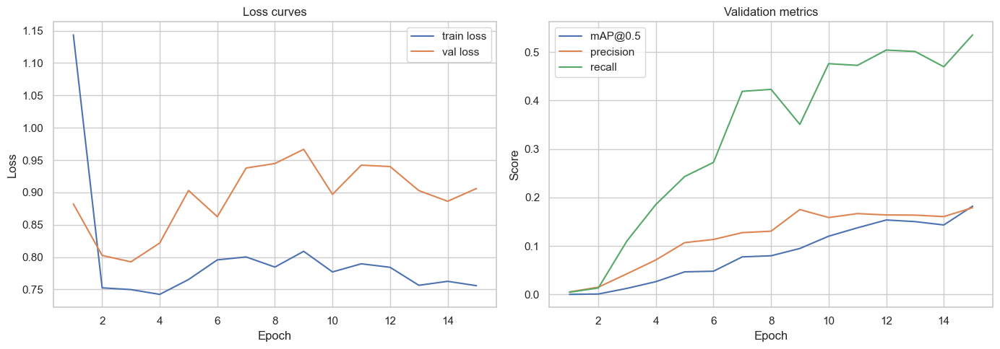

In [57]:
if best_history_df.empty:
    print("History is empty. Run the Optuna training cell first.")
else:
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    axes[0].plot(best_history_df["epoch"], best_history_df["train_loss"], label="train loss")
    axes[0].plot(best_history_df["epoch"], best_history_df["val_loss"], label="val loss")
    axes[0].set_title("Loss curves")
    axes[0].set_xlabel("Epoch")
    axes[0].set_ylabel("Loss")
    axes[0].legend()

    axes[1].plot(best_history_df["epoch"], best_history_df["map50"], label="mAP@0.5")
    axes[1].plot(best_history_df["epoch"], best_history_df["precision"], label="precision")
    axes[1].plot(best_history_df["epoch"], best_history_df["recall"], label="recall")
    axes[1].set_title("Validation metrics")
    axes[1].set_xlabel("Epoch")
    axes[1].set_ylabel("Score")
    axes[1].legend()
    plt.tight_layout()
    plt.show()


## Evaluation on held-out data

Load the best Optuna checkpoint and compute detection metrics on the validation and test splits.


In [52]:
if not BEST_MODEL_PATH.exists():
    raise FileNotFoundError("Training has not produced a checkpoint yet — run the Optuna cell above.")

checkpoint = torch.load(BEST_MODEL_PATH, map_location=device)
best_model = build_model_instance()
best_model.load_state_dict(checkpoint["model_state"])
best_model.to(device)

val_metrics = evaluate_detector(best_model, val_loader, device, score_threshold=EVAL_SCORE_THRESHOLD)
test_metrics = evaluate_detector(best_model, test_loader, device, score_threshold=EVAL_SCORE_THRESHOLD)

metrics_df = pd.DataFrame([val_metrics, test_metrics], index=["val", "test"])
metrics_df


Eval:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

,mAP@0.5,precision,recall,detections_per_image,detection_coverage,mean_score
val,0.265454,0.225142,0.609192,91.6,1.0,0.627248
test,0.278128,0.224579,0.666378,81.7,1.0,0.584435


## Test-time inference visualization

Compare predicted and ground-truth bounding boxes on a random test tile. Predictions are shown in red with objectness scores, and ground truth in green.


Sample test tile: cc4f3226-c262-409e-a4b2-a576e776f7f4.jpg


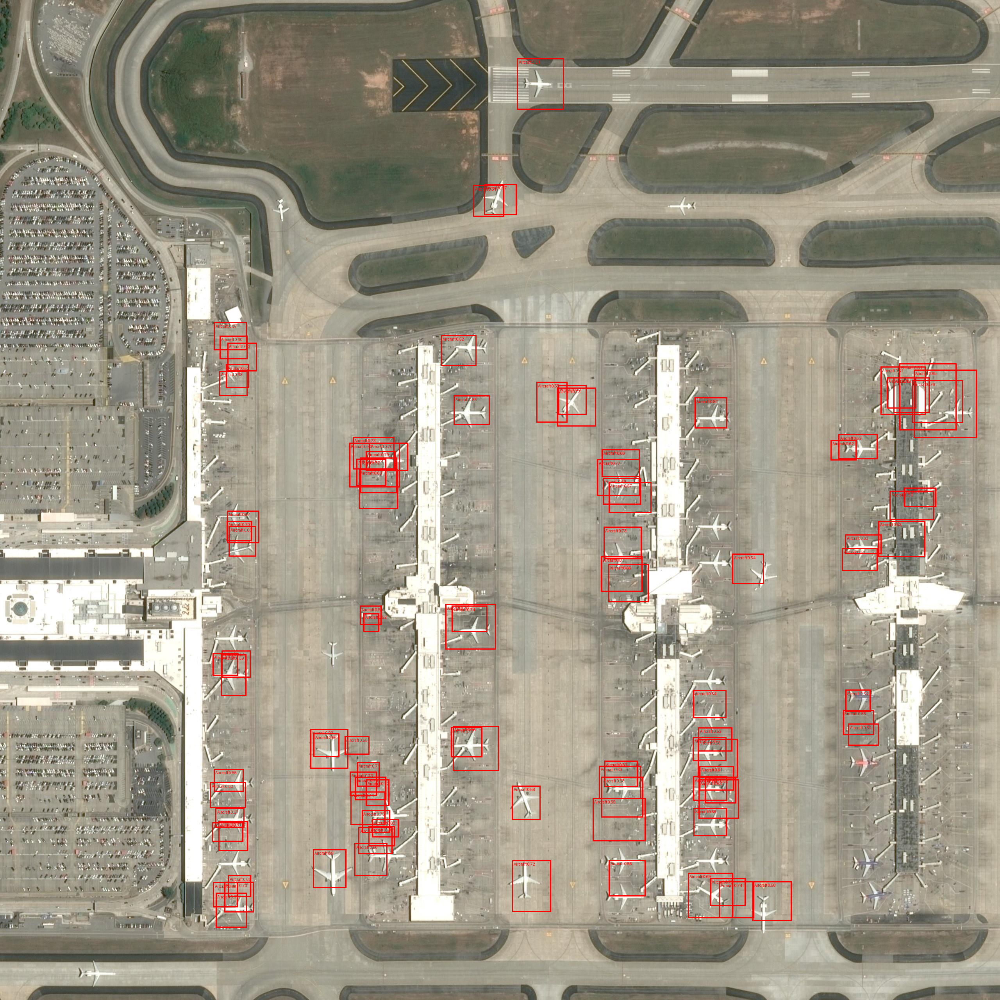

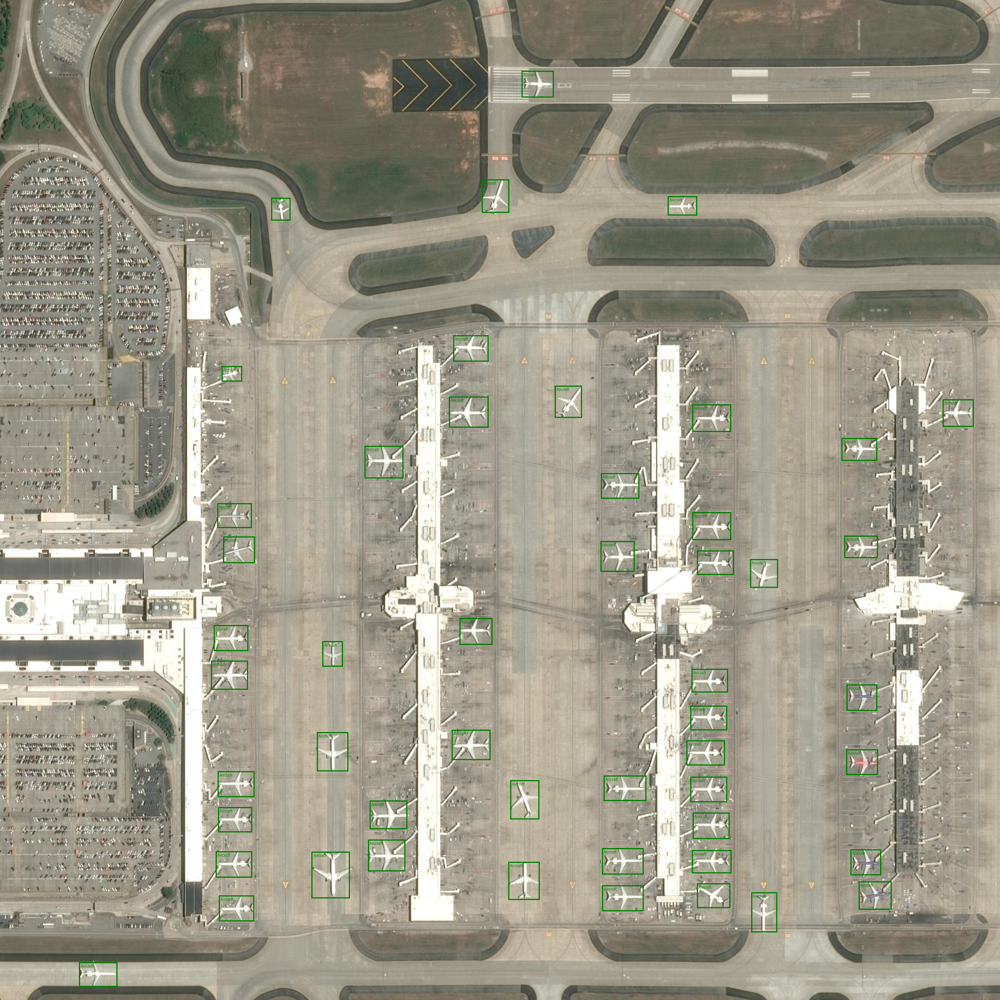

In [54]:
if "best_model" not in globals():
    if not BEST_MODEL_PATH.exists():
        raise FileNotFoundError("No trained model found. Run the training/eval cells first.")
    checkpoint = torch.load(BEST_MODEL_PATH, map_location=device)
    best_model = build_model_instance()
    best_model.load_state_dict(checkpoint["model_state"])
    best_model.to(device)

best_model.eval()

sample_image_id = random.choice(splits["test"])
sample_record = records[sample_image_id]
raw_image = Image.open(sample_record.image_path).convert("RGB")
orig_w, orig_h = raw_image.size

input_tensor = raw_image.resize((IMAGE_SIZE, IMAGE_SIZE), Image.BILINEAR)
input_tensor = F.to_tensor(input_tensor)
input_tensor = F.normalize(input_tensor, mean=ALEXNET_MEAN, std=ALEXNET_STD).unsqueeze(0).to(device)

with torch.no_grad():
    prediction = best_model(input_tensor)[0]

keep = prediction["scores"] >= EVAL_SCORE_THRESHOLD
pred_boxes = prediction["boxes"][keep].cpu().clone()
pred_scores = prediction["scores"][keep].cpu().tolist()
pred_labels = prediction["labels"][keep].cpu().tolist()

scale_x = orig_w / IMAGE_SIZE
scale_y = orig_h / IMAGE_SIZE
pred_boxes[:, [0, 2]] *= scale_x
pred_boxes[:, [1, 3]] *= scale_y

pred_vis = raw_image.copy()
draw_pred = ImageDraw.Draw(pred_vis)
for box, score, label in zip(pred_boxes, pred_scores, pred_labels):
    box = box.tolist()
    draw_pred.rectangle(box, outline="red", width=3)
    class_name = IDX_TO_CLASS.get(label, "Aircraft")
    draw_pred.text((box[0] + 4, box[1] + 4), f"{class_name} {score:.2f}", fill="red")

gt_vis = raw_image.copy()
draw_gt = ImageDraw.Draw(gt_vis)
for box, label in zip(sample_record.boxes, sample_record.labels):
    box = box.tolist()
    draw_gt.rectangle(box, outline="green", width=3)
    class_name = IDX_TO_CLASS.get(int(label), "Aircraft")
    draw_gt.text((box[0] + 4, box[1] + 4), class_name, fill="green")

print(f"Sample test tile: {sample_image_id}")
display.display(pred_vis)
display.display(gt_vis)
